In [1]:
import pylab as plt
import sep
from matplotlib.patches import Ellipse
import numpy as np
from tifffile import imread
import cv2
import pandas as pd
from scipy.ndimage import shift
#import plotly.graph_objects as go
np.set_printoptions(legacy='1.25')

In [2]:
#functions to count both the number of beads and save their position values

def star_counter(sum_average,threshold):
    sum_average = sum_average.astype(np.float32)
   #this cell finds the number of detectable stars in the image using the adaptive row and column averaging method
    sum_average = np.array(sum_average)

    mean_avg, std_avg = np.mean(sum_average), np.std(sum_average)
    sumobjects = sep.extract(sum_average, threshold, clean = False)
    
    # plot background-subtracted image
    fig, ax = plt.subplots() 
    im = ax.imshow(sum_average, interpolation='nearest', cmap='gray',
                   vmin = mean_avg-std_avg, vmax=mean_avg+std_avg, origin='lower')
    
    
    #plot an ellipse for each object
    for i in range(len(sumobjects)):
        e = Ellipse(xy=(sumobjects['x'][i], sumobjects['y'][i]),
                    width=6*sumobjects['a'][i],
                    height=6*sumobjects['b'][i],
                    angle=sumobjects['theta'][i] * 180. / np.pi)
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
    
    sumflux, sumfluxerr, sumflag = sep.sum_circle(sum_average, sumobjects['x'], sumobjects['y'],
                                         3.0, gain=1.0)
    plt.show()

    print(len(sumobjects))
    return len(sumobjects)


    #finds the stars in an image and saves their positions for plotting
def star_counter_position(sum_average,threshold):
    sum_average = sum_average.astype(np.float32)
   #this cell finds the number of detectable stars in the image using the adaptive row and column averaging method
    sum_average = np.array(sum_average)

    mean_avg, std_avg = np.mean(sum_average), np.std(sum_average)
    sumobjects = sep.extract(sum_average, threshold, clean = False)
    
    # plot background-subtracted image
    fig, ax = plt.subplots()
    im = ax.imshow(sum_average, interpolation='nearest', cmap='gray',
                   vmin = mean_avg-std_avg, vmax=mean_avg+std_avg, origin='lower')
    
    
    #plot an ellipse for each object
    for i in range(len(sumobjects)):
        e = Ellipse(xy=(sumobjects['x'][i], sumobjects['y'][i]),
                    width=6*sumobjects['a'][i],
                    height=6*sumobjects['b'][i],
                    angle=sumobjects['theta'][i] * 180. / np.pi)
        e.set_facecolor('none')
        e.set_edgecolor('red')
        ax.add_artist(e)
    
    sumflux, sumfluxerr, sumflag = sep.sum_circle(sum_average, sumobjects['x'], sumobjects['y'],
                                         3.0, gain=1.0)
    plt.show()

    print(len(sumobjects))
    return sumobjects

In [3]:
#finds the beads/position for the first few slices in channel 1 to compare to the first slice in channel 0


def bead_detect(slice_num,slice_range,stack_1,threshold_other,threshold_test):
    #holds all the positions for each slice in the channel
    stack_1beads = []

    #since indexing starts at 0, subtract one from the slice number
    slice_num -= 1
    
    for i in range(slice_range):
        stack_1beads.append(star_counter_position(stack_1[i],np.mean(stack_1[i])+np.std(stack_1[i])+threshold_other))

    #gets the beads and positions for channel 0
    print("channel 0 is below")
    pos_stack0 = star_counter_position(stack_0[slice_num],np.mean(stack_0[slice_num])+np.std(stack_0[slice_num])+threshold_test)

    return pos_stack0, slice_num, stack_1beads

In [4]:
#finds the dispersion in each slice by calculating the root mean square distance

def offset_function(pos_stack0,stack_1beads,slice_num):
    rms = [] 
    
    mean_0x = np.mean(pos_stack0['x'])
    mean_0y = np.mean(pos_stack0['y'])
    
    for i in range(len(stack_1beads)):
    
        dist = 0
        num_elem = len(stack_1beads[i])
        
        mean_1x = np.mean(stack_1beads[i]['x'])
        mean_1y = np.mean(stack_1beads[i]['y'])
        
        for j in range(num_elem):
    
            dist += (stack_1beads[i][j]['x']-mean_1x)**2+(stack_1beads[i][j]['y']-mean_1y)**2
            
        rms.append(np.sqrt(dist/(num_elem)))
    
    
    dist = 0
    
    for i in range(len(pos_stack0['x'])):
        
        dist += (pos_stack0[i]['x'] - mean_0x)**2 + (pos_stack0[i]['y'] - mean_0y)**2
    
    rms_0 = np.sqrt(dist/len(pos_stack0['x']))

    
    #finds the slices with the most similar dispersion compared to the test case
    difference = []
    dif = {}
    for i in range(len(rms)):
        dif.update({i:abs(rms[i]-rms_0)})
        difference.append(abs(rms[i]-rms_0))
    
    sorted_dif = dict(sorted(dif.items(), key=lambda item: item[1]))
    
    counter = 0
    smallest_key = 0
    
    #print("best matches for slice ",slice_num+1," in channel 0 are slices")
    for key, value in sorted_dif.items():
        counter += 1

        if(counter == 1):
            smallest_key = key
        
        #if(counter <= 10):
            # +1 is included since the slices start at 0
            #print(key+1,"difference = ", value)

    return difference,rms_0,sorted_dif

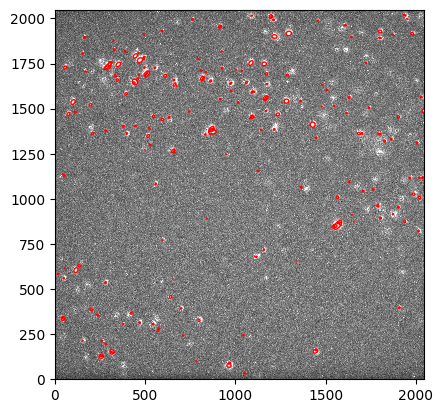

200


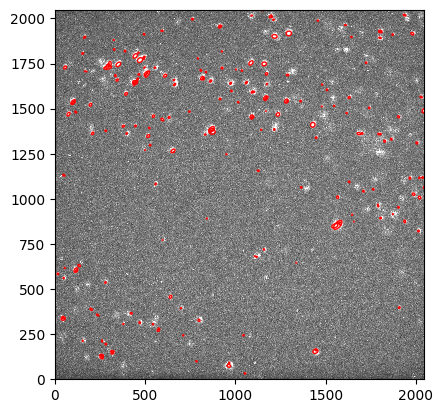

204


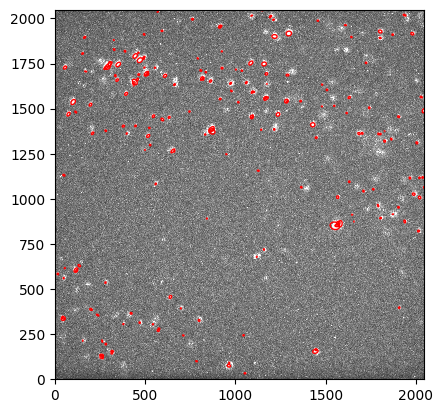

203


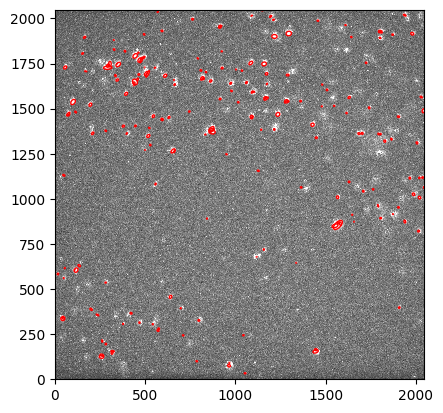

204


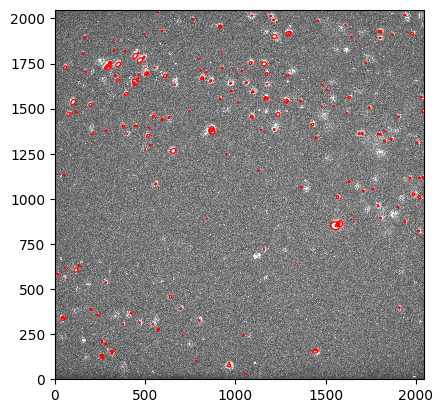

197


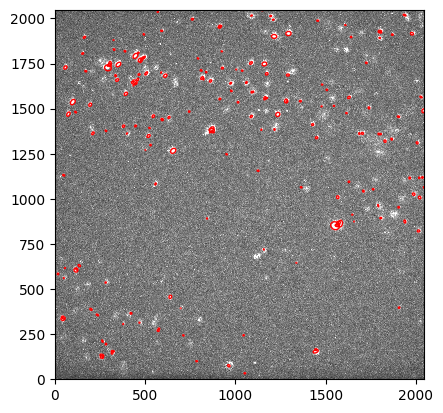

186


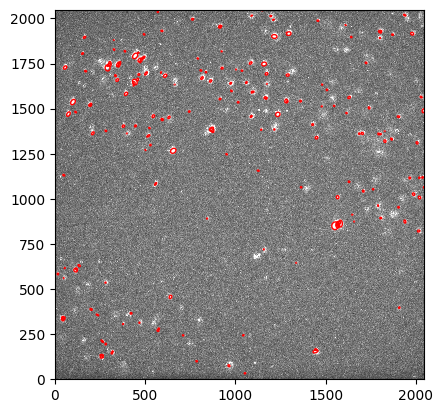

191


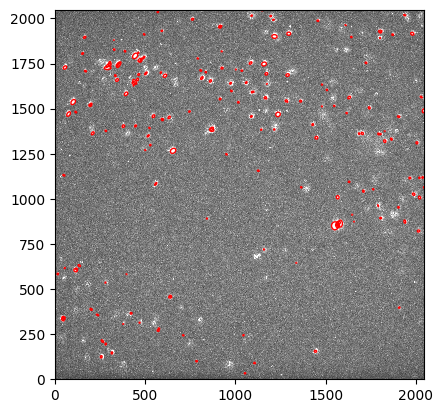

186


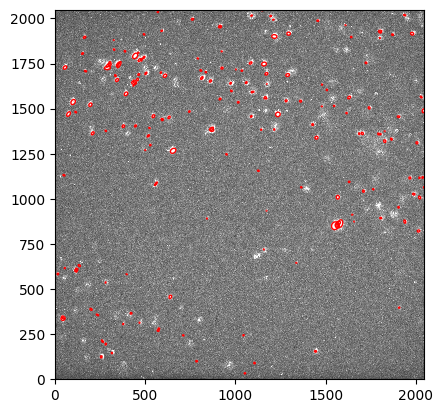

183


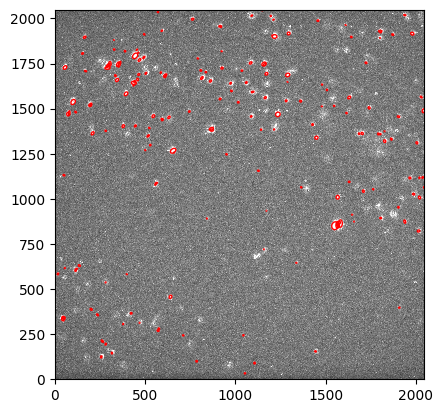

189


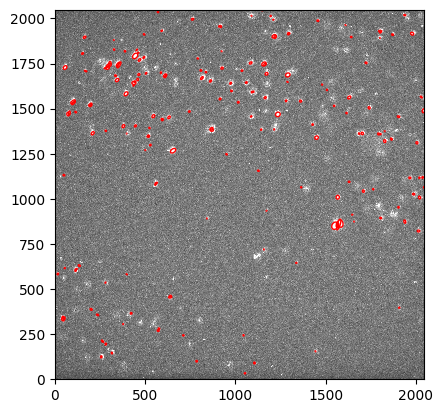

190


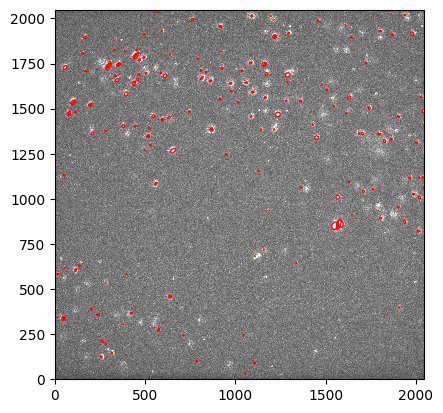

189


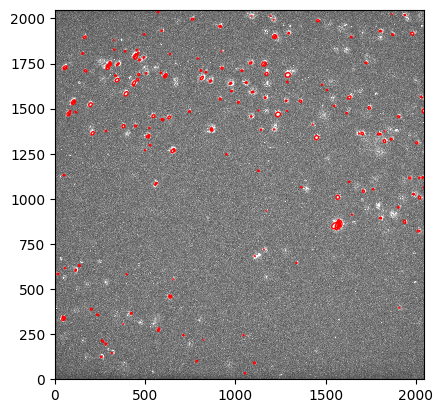

184


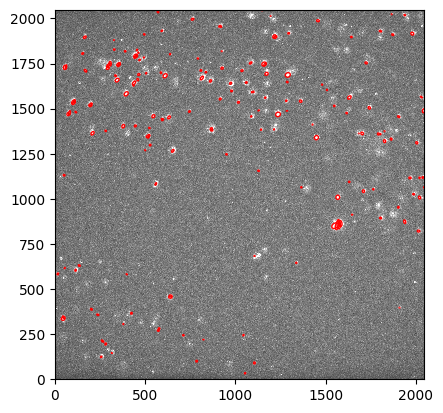

178


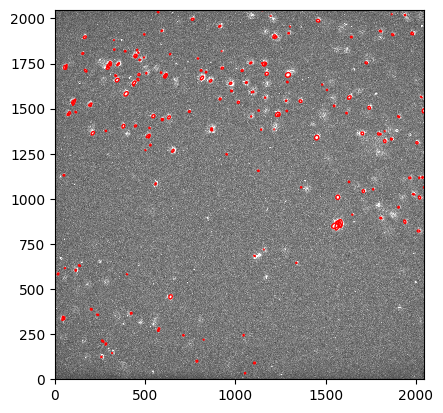

178


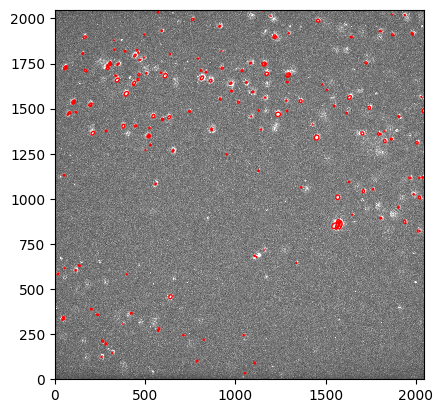

177


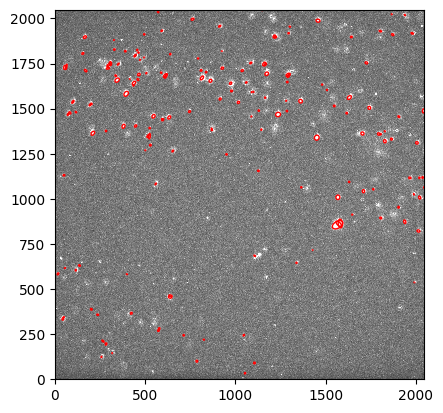

170


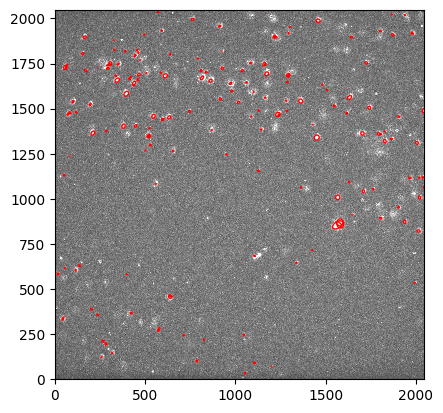

172


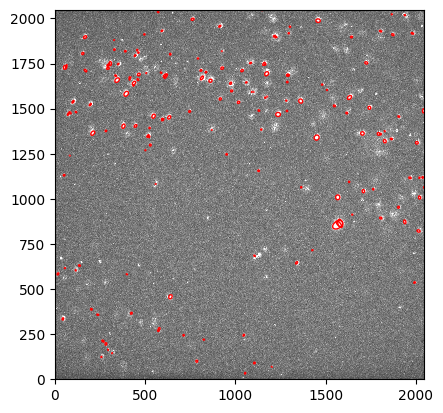

171


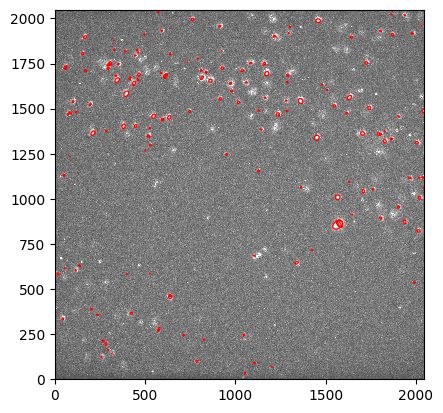

168


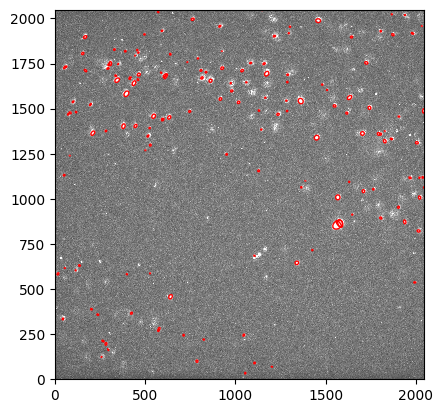

157


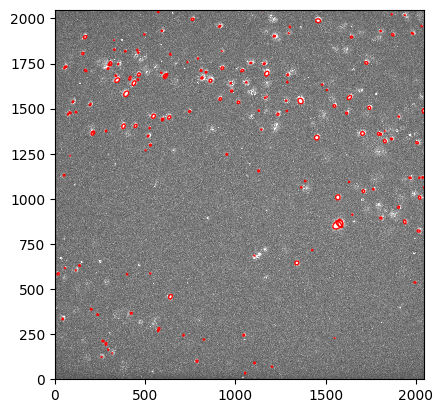

159


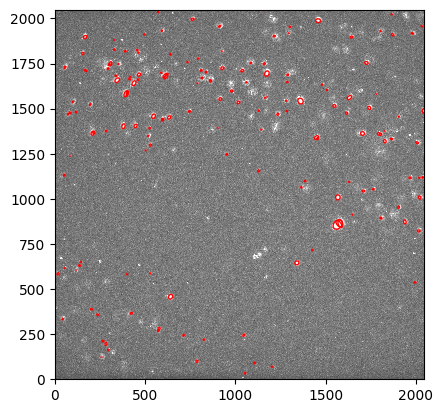

160


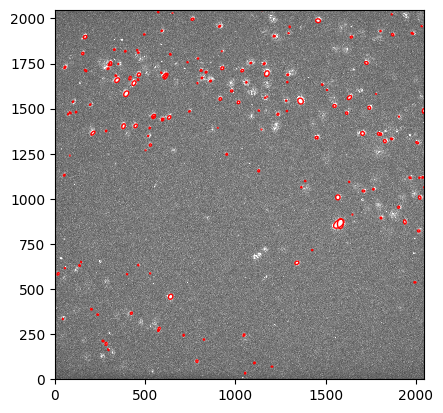

156


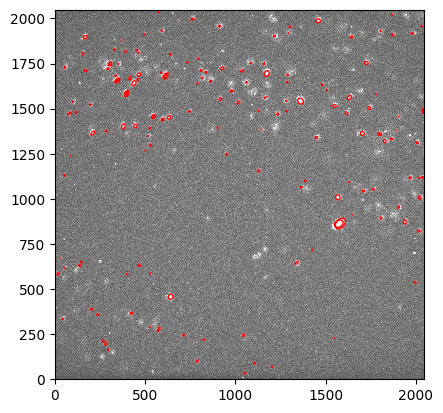

166


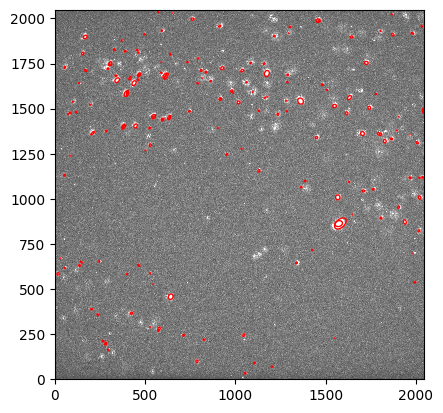

176


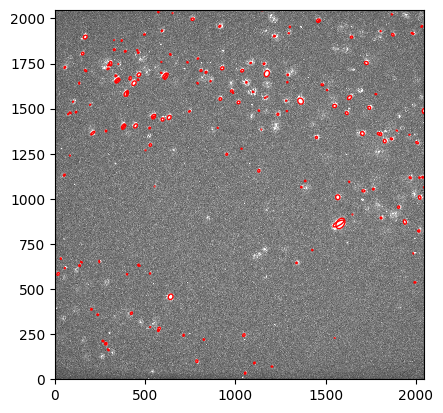

175


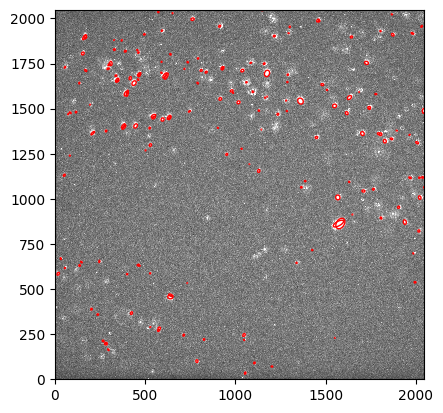

181


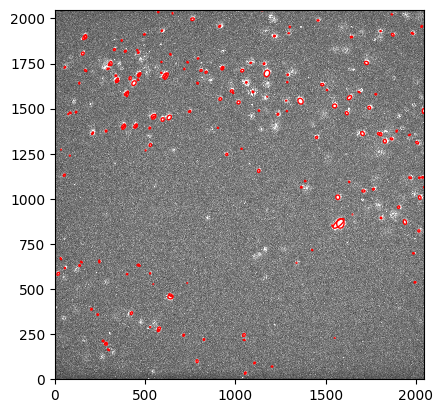

176


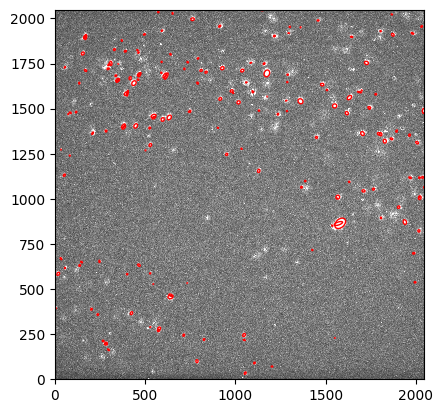

179


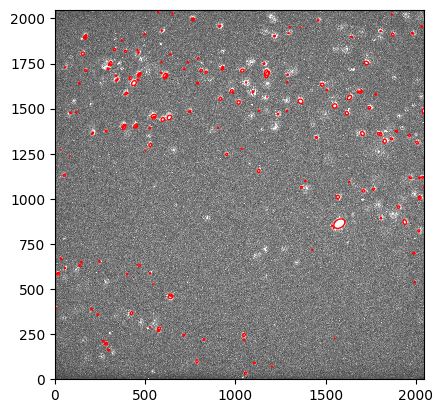

181


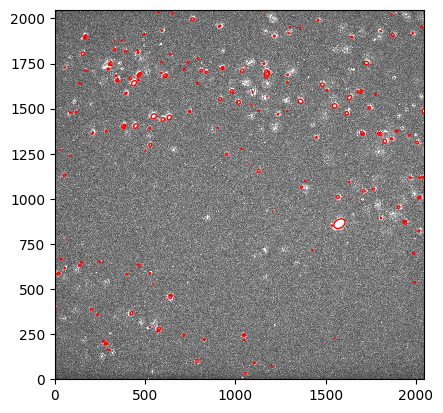

185


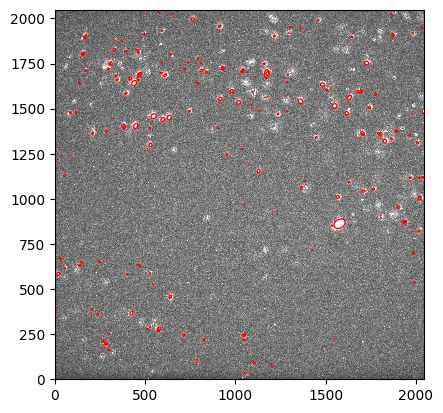

184


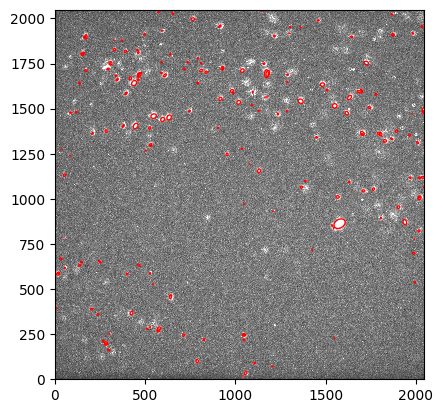

187


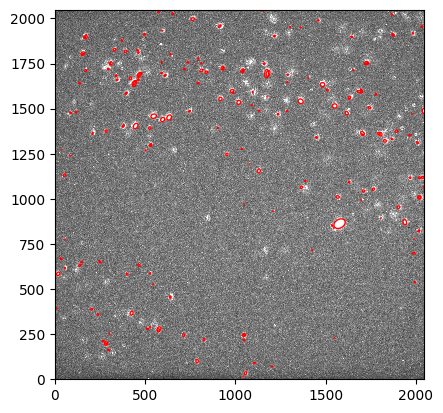

187


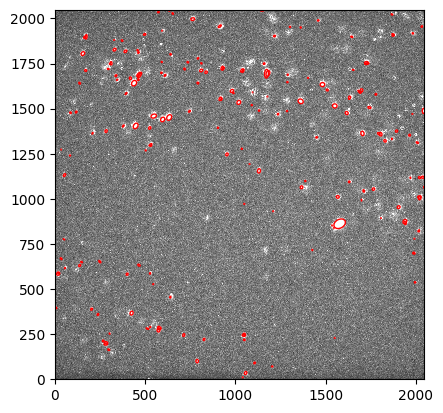

188


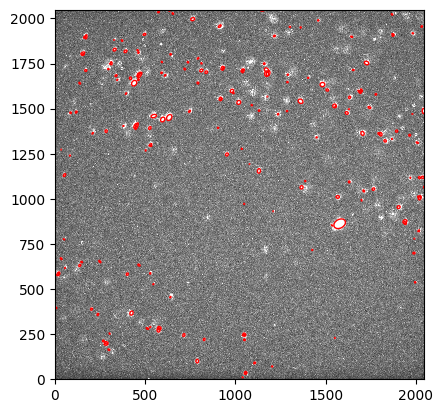

189


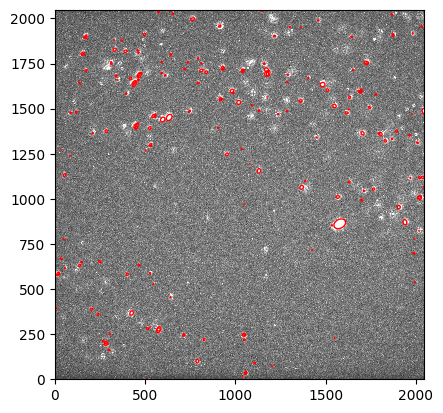

188


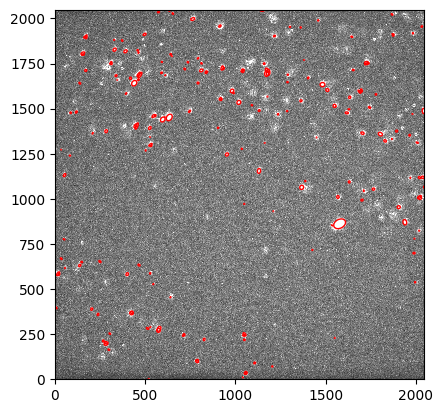

194


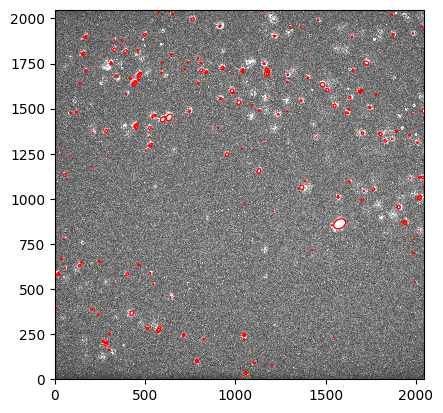

193


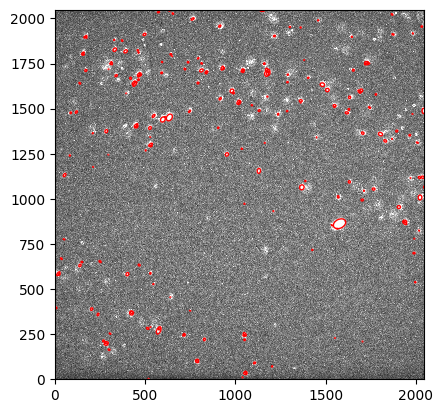

196


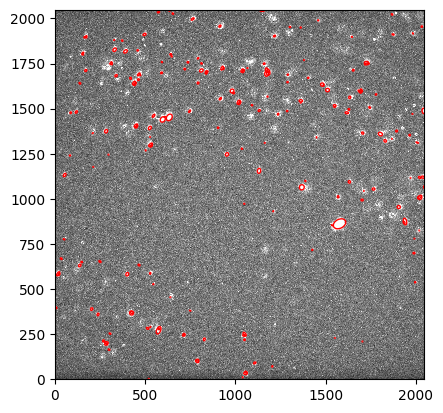

198


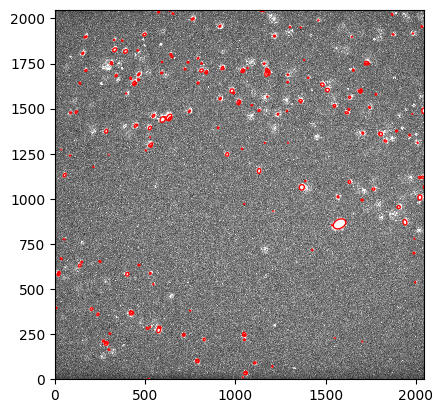

188


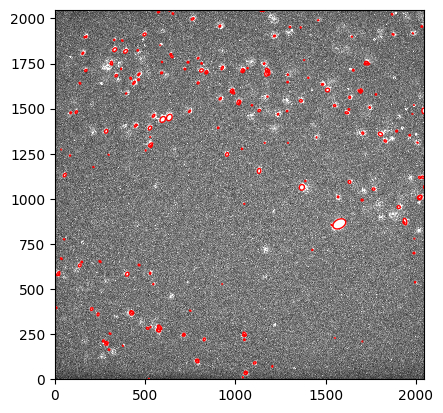

190


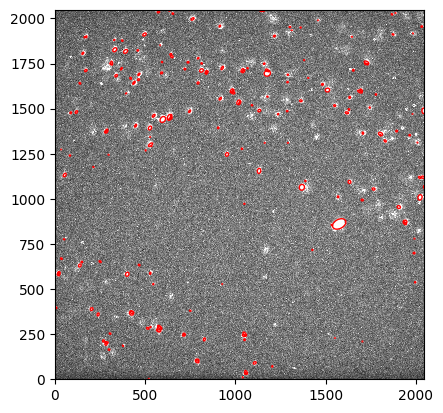

191


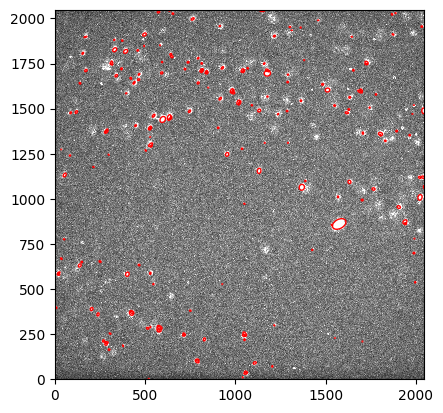

196


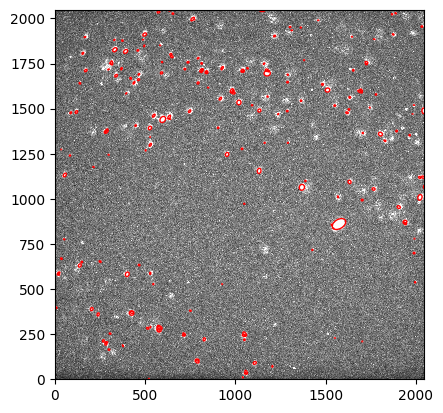

195


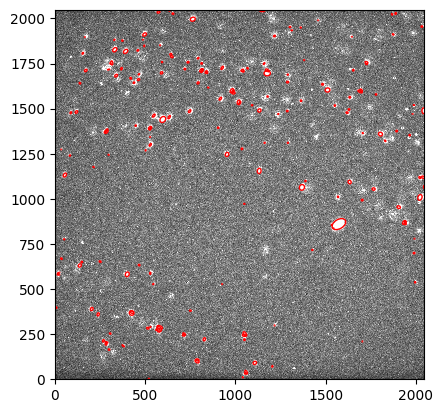

192


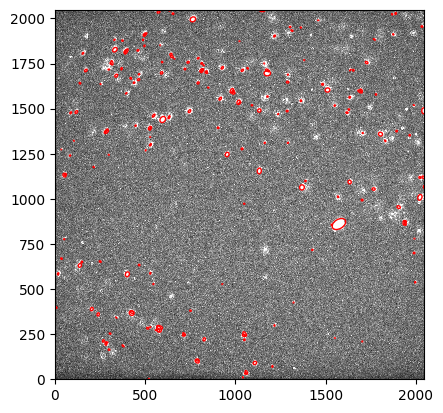

197


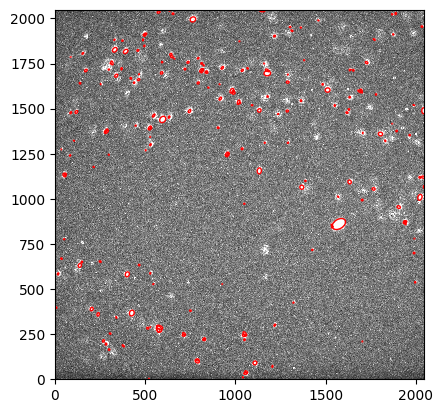

199


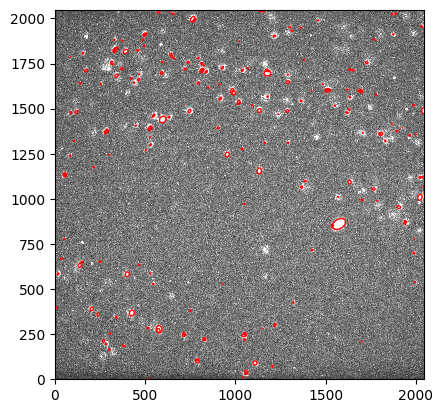

205


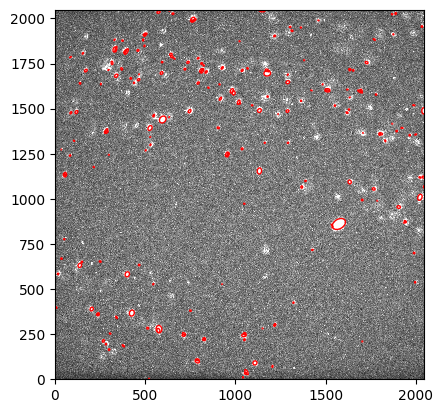

207


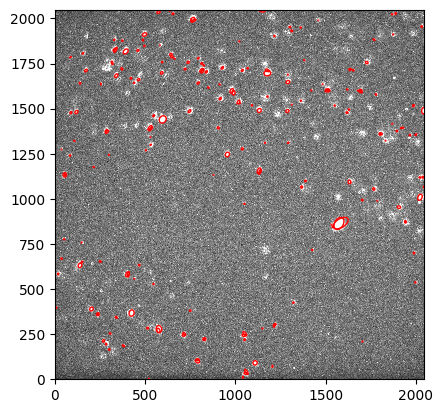

204


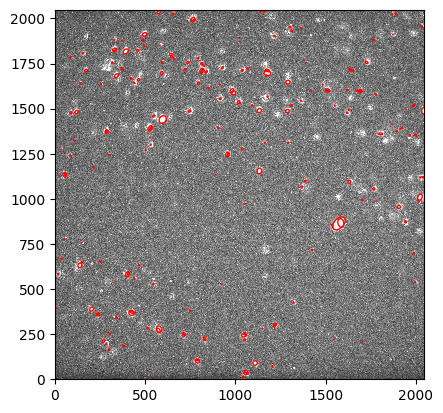

208


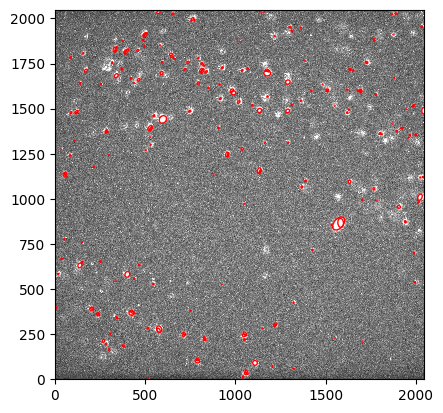

217


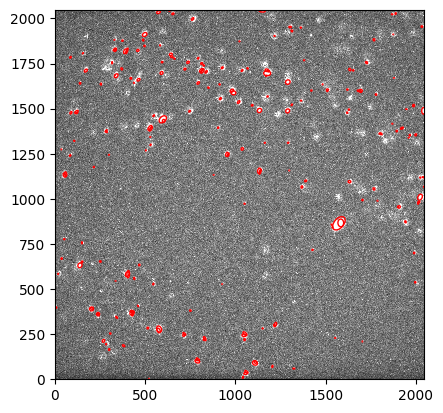

217


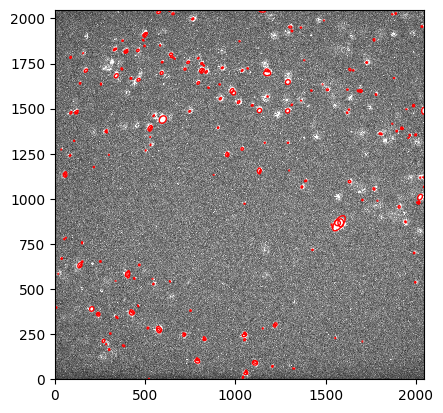

216


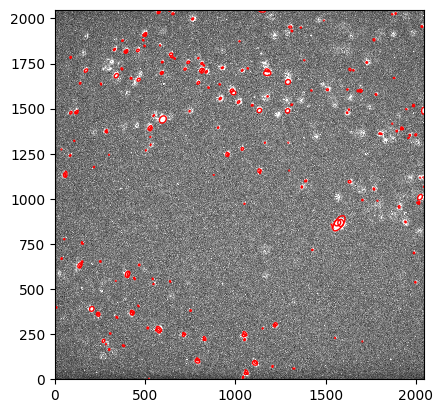

213


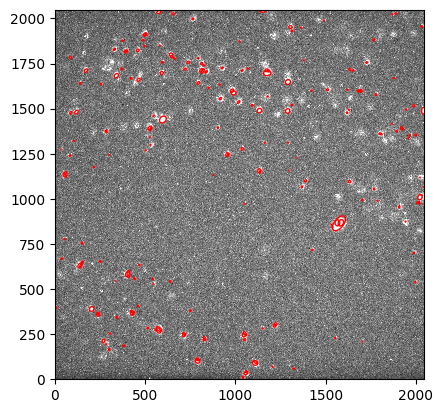

209


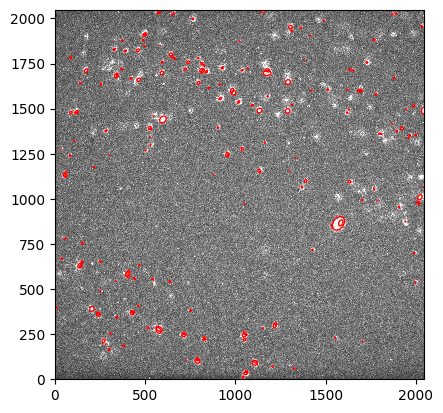

204


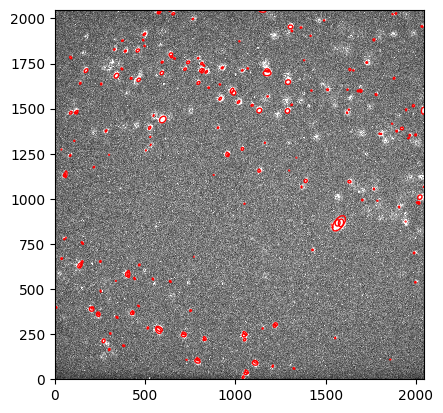

200


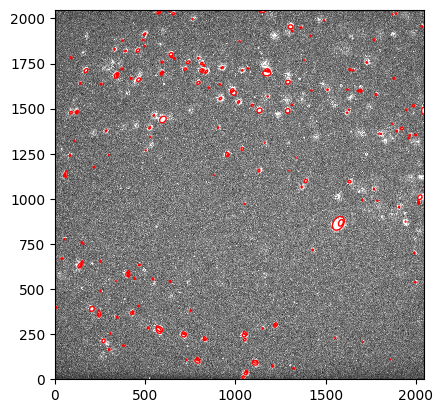

195


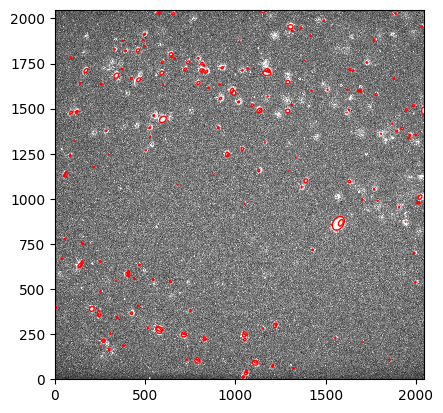

194


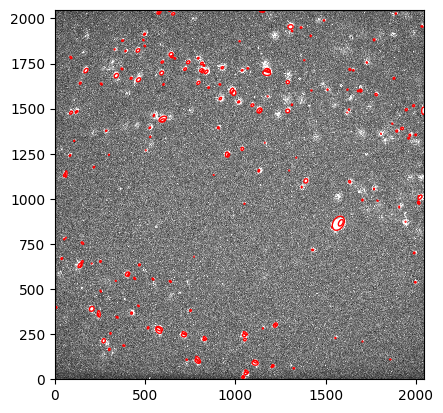

192


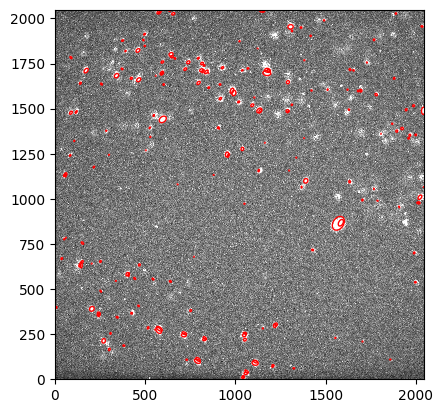

197


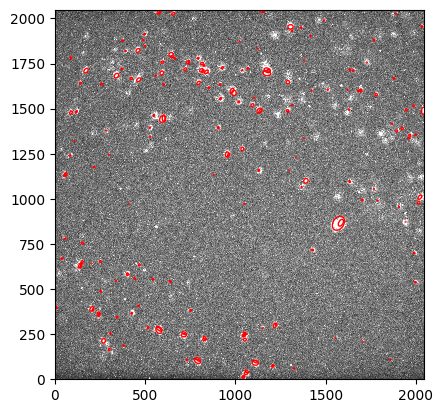

192


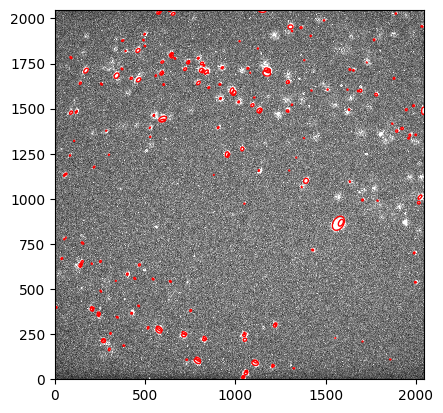

193


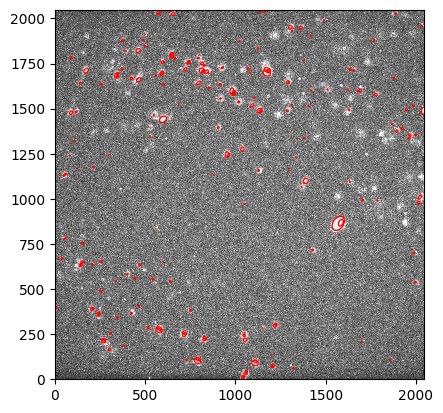

200


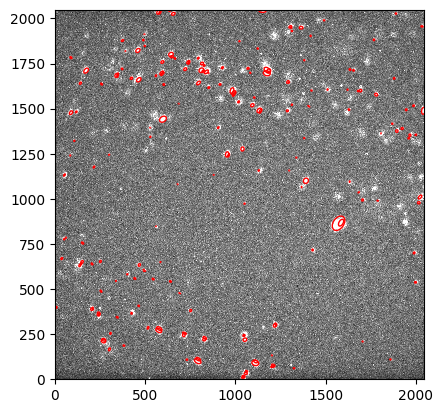

196


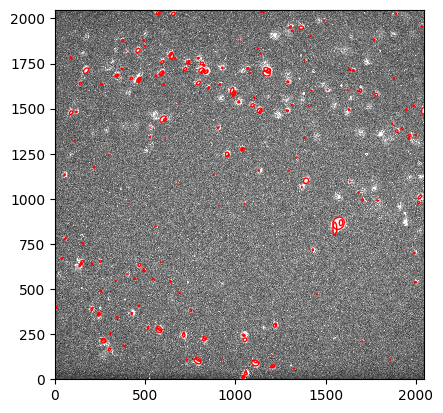

203


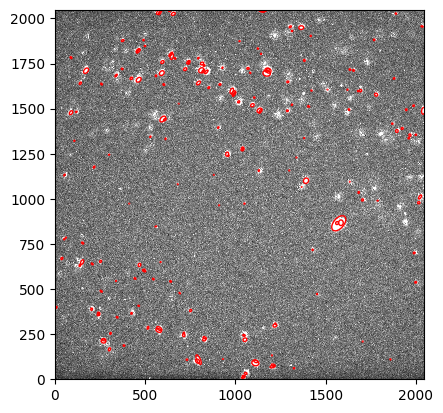

186


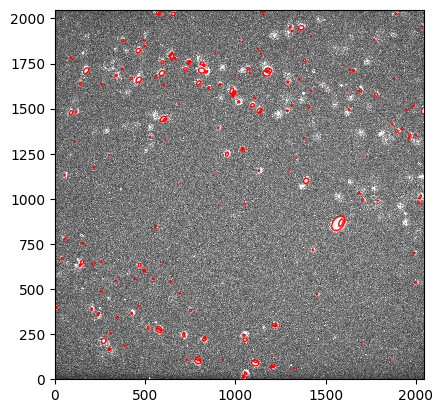

184


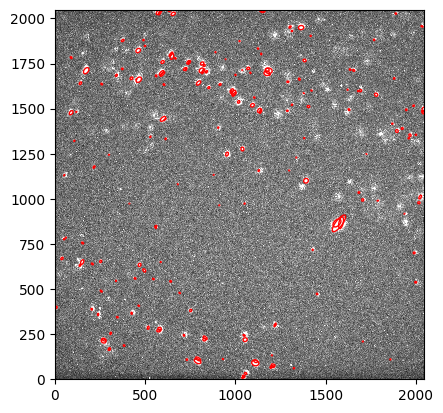

192


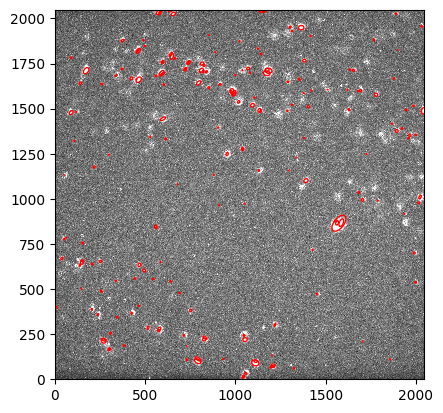

198


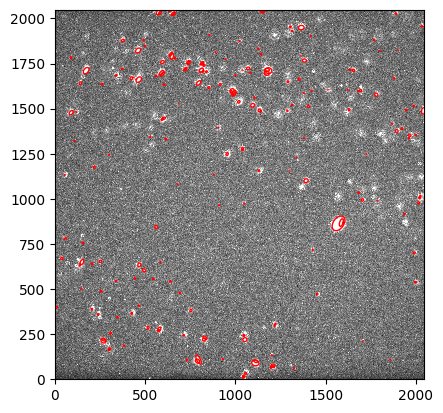

203


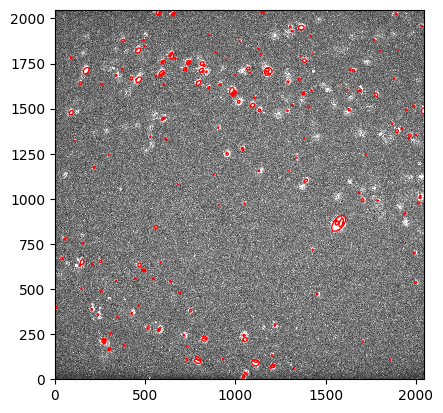

209


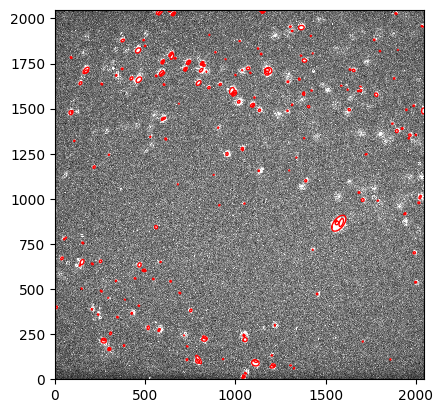

206


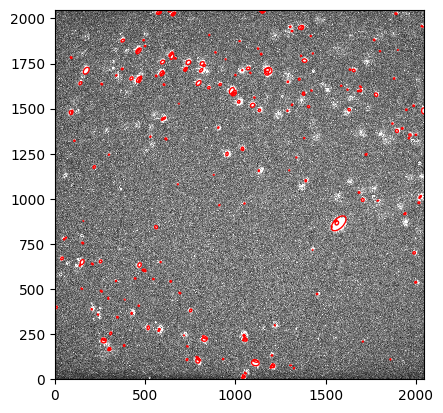

212


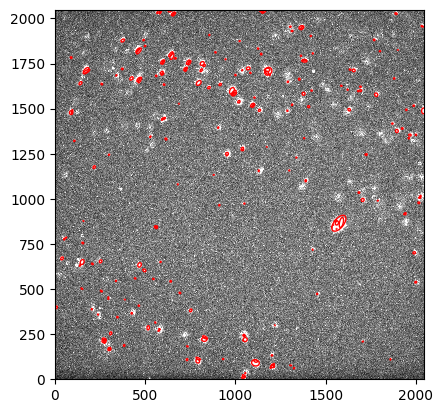

221


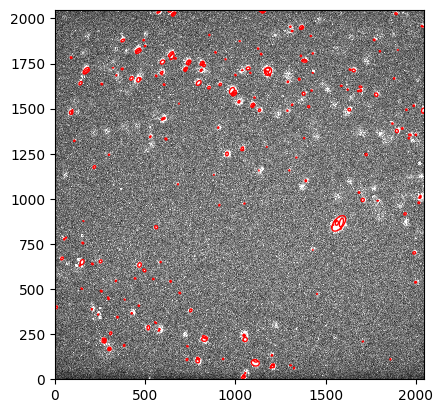

217


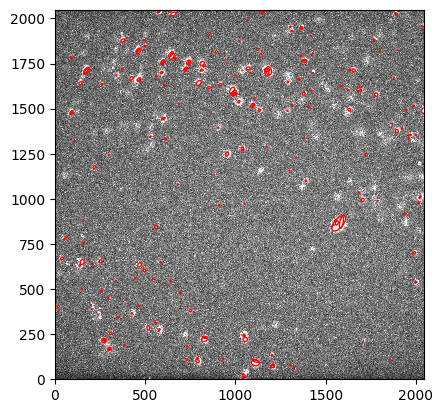

217


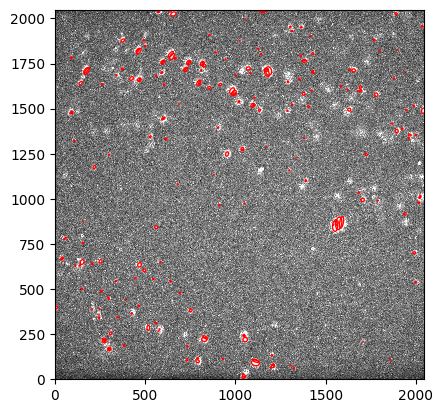

217


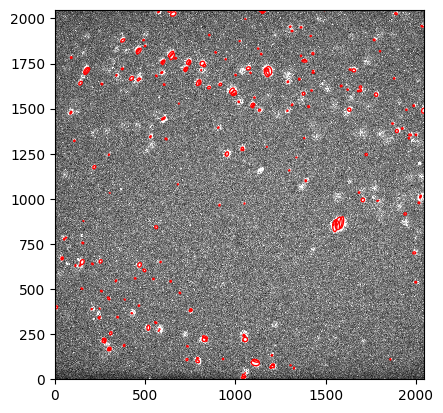

220


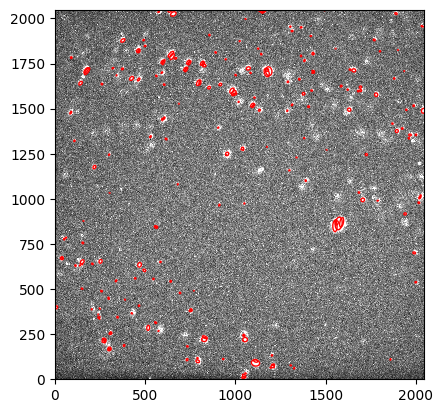

229


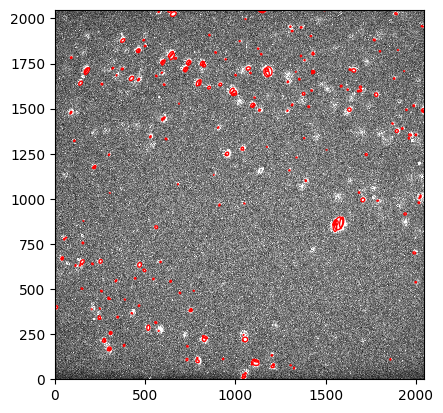

230


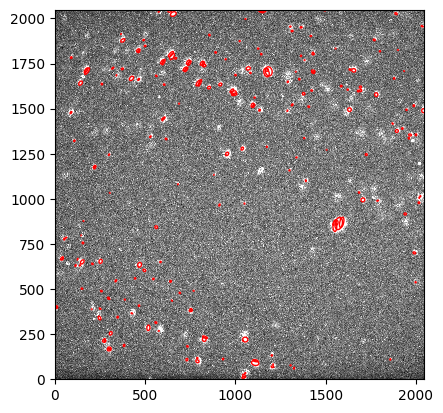

224


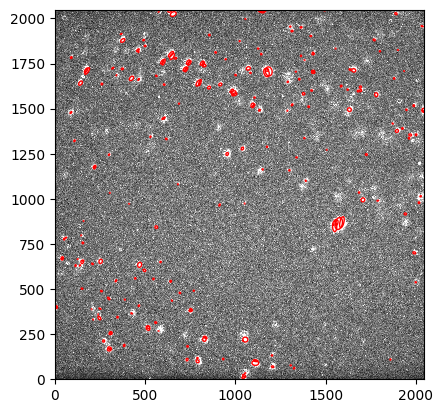

222


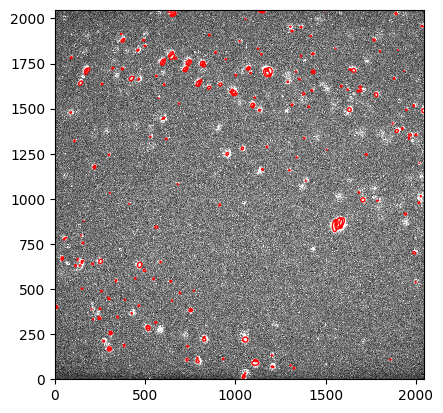

227


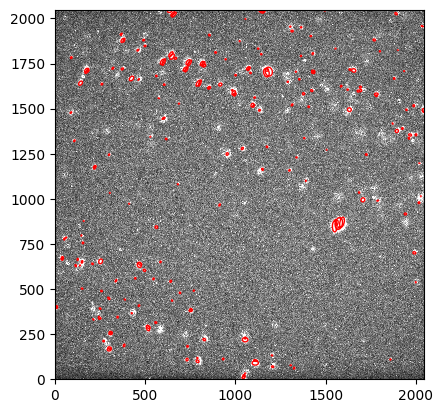

227


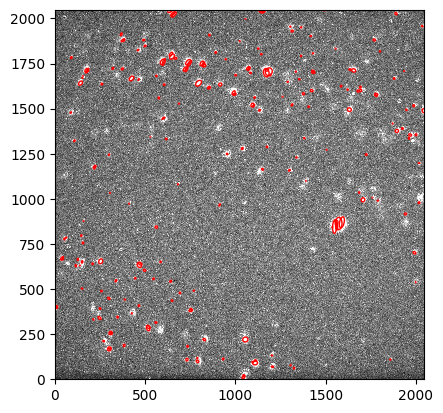

227


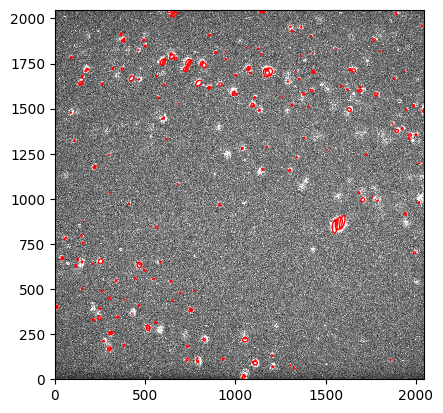

218


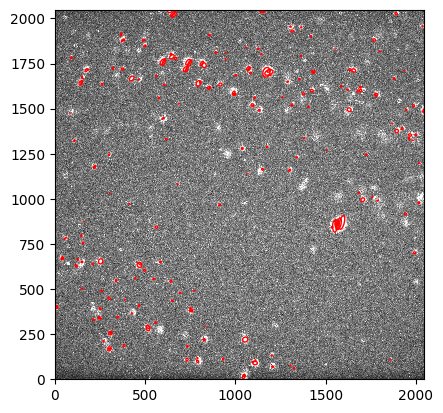

229


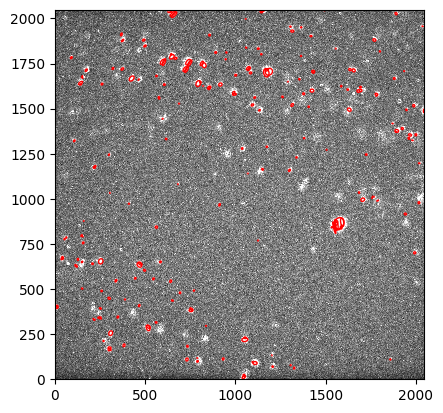

220


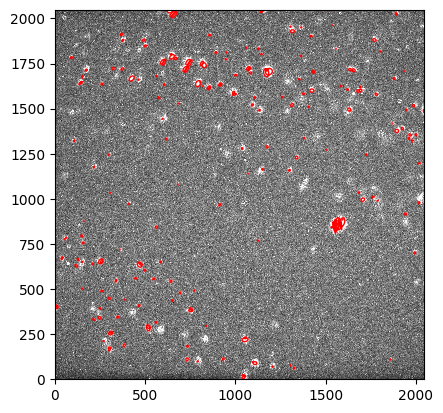

216


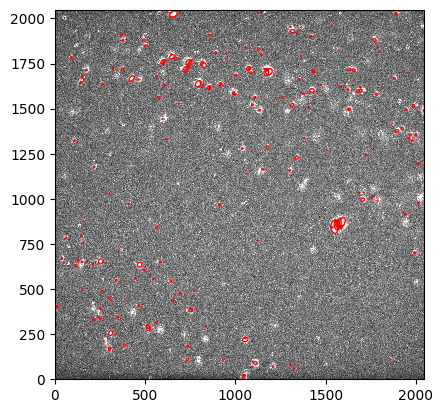

209


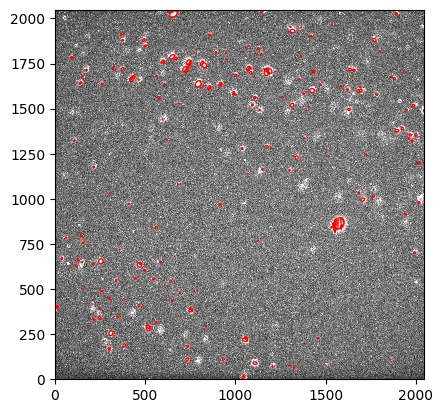

221


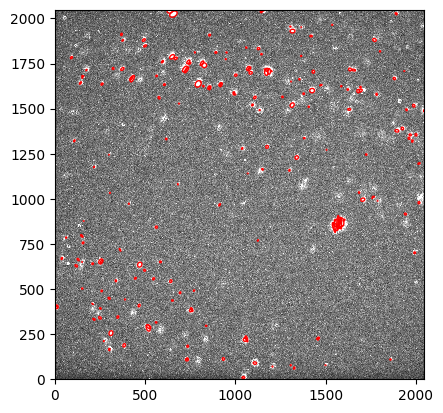

211


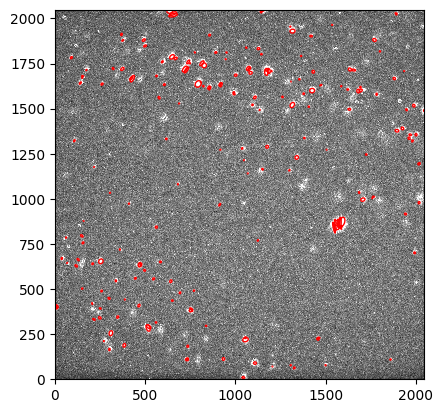

210


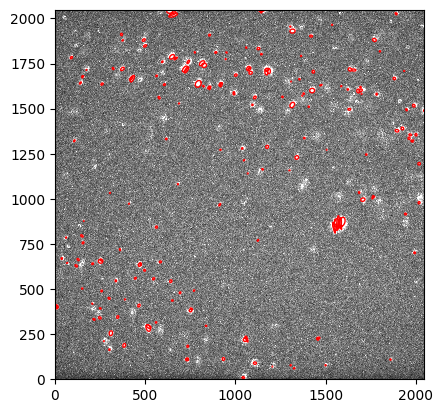

206


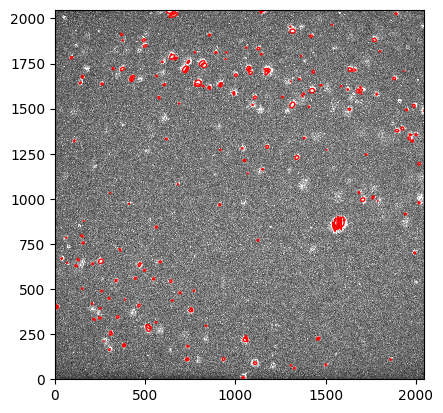

217


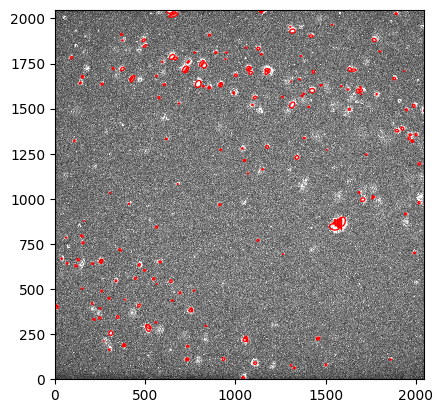

208


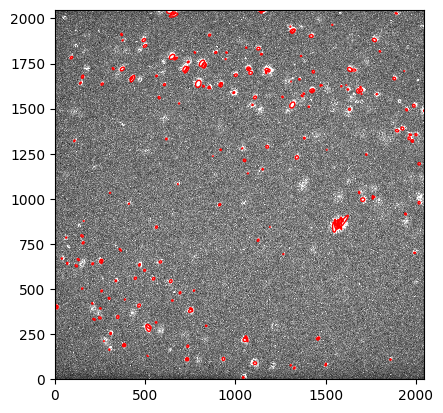

217


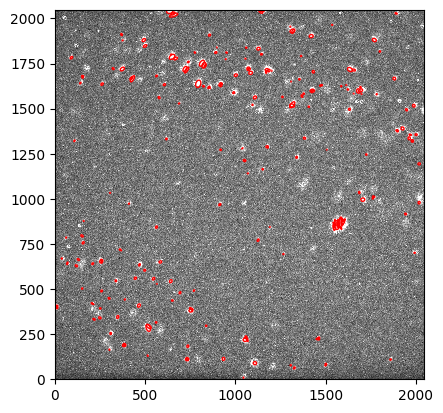

222


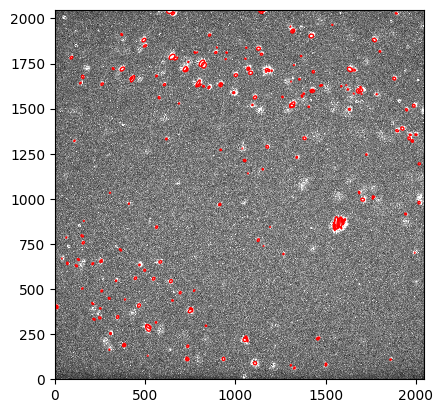

216


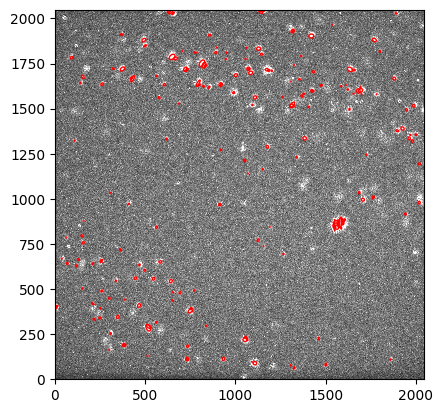

215


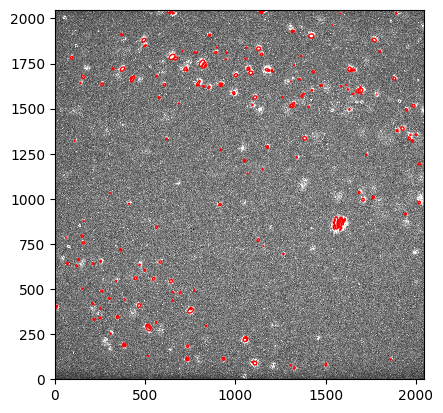

216


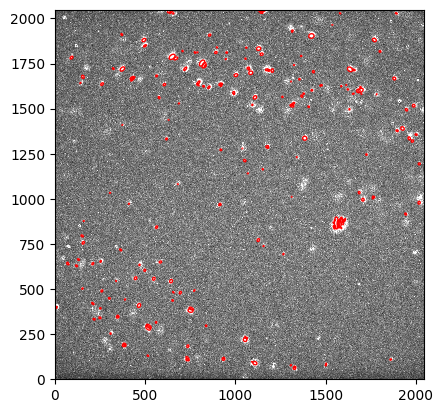

211


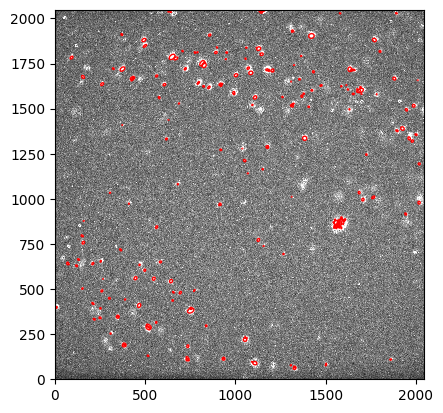

209


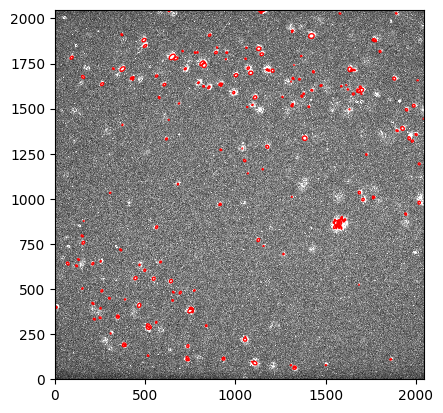

205


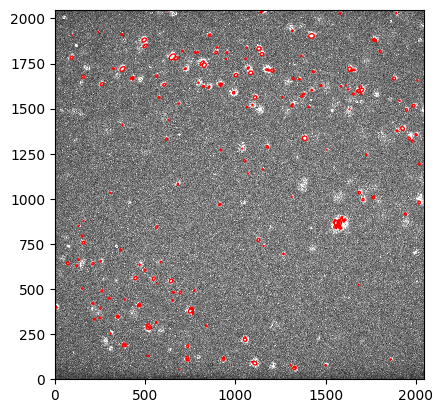

205


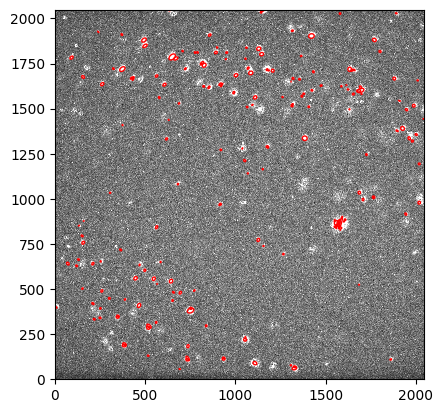

194


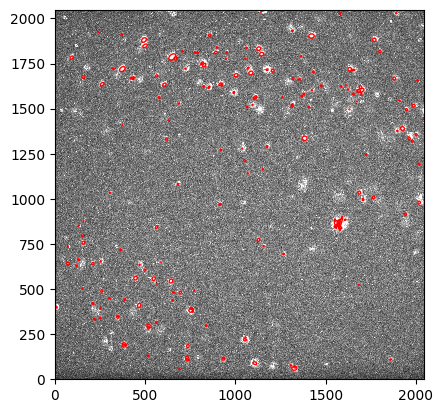

197


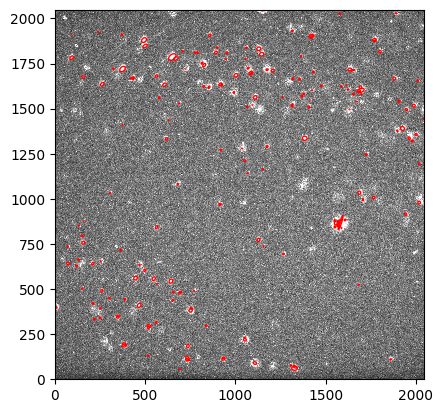

193


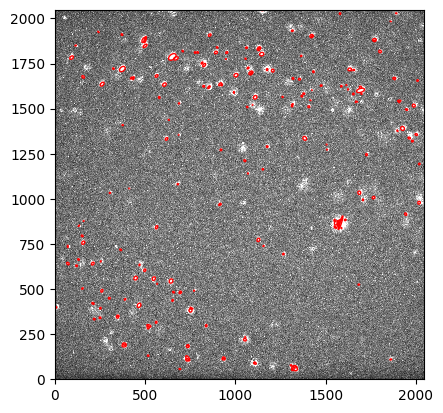

197


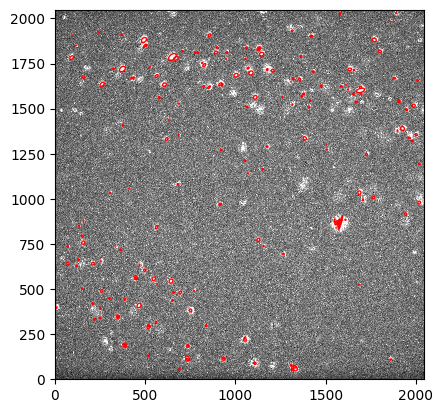

201


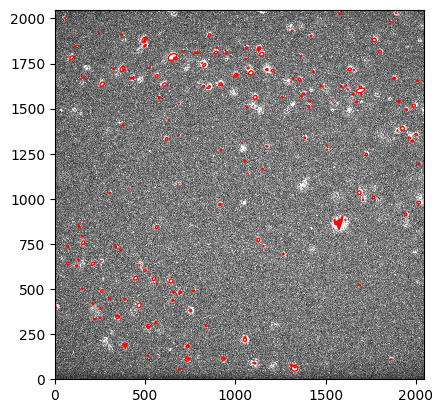

200


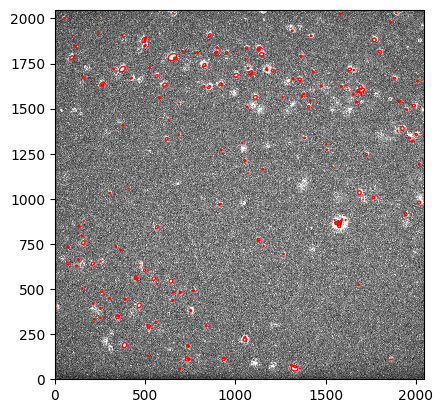

200


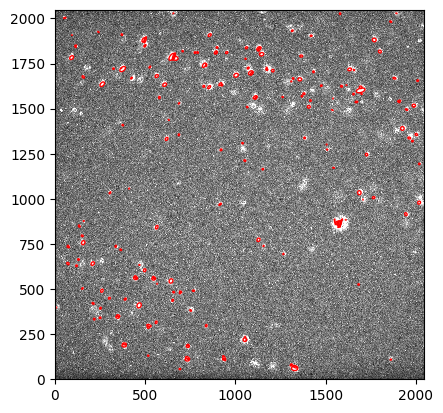

202


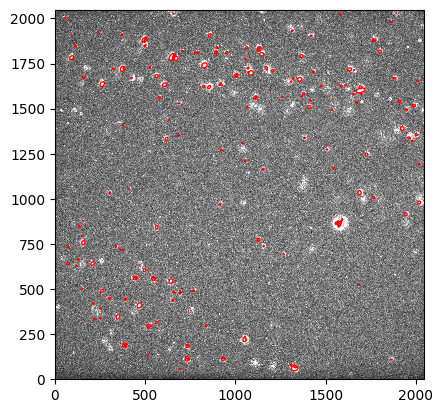

197


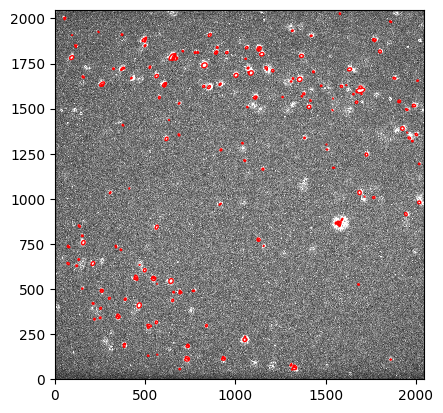

194


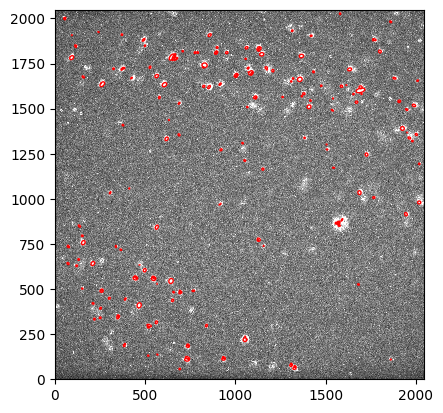

190


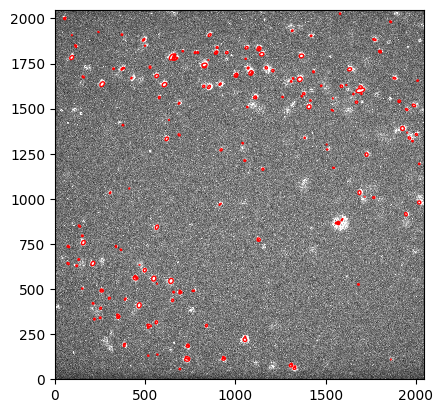

186


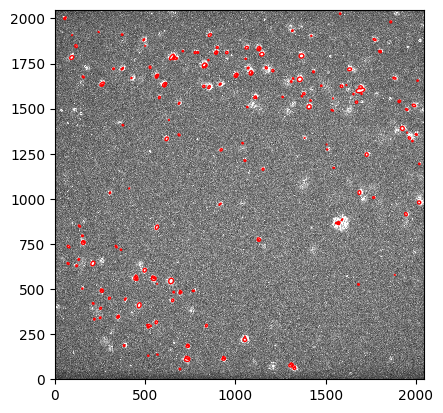

189


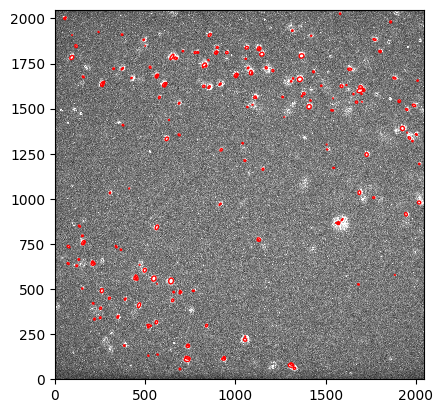

187


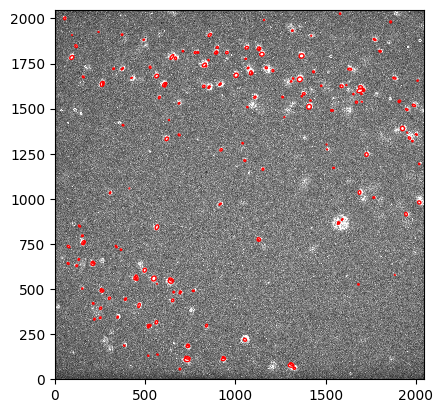

178


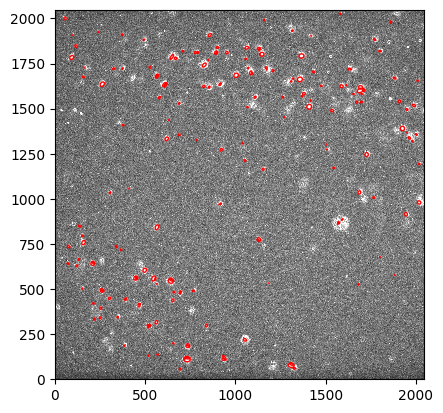

188


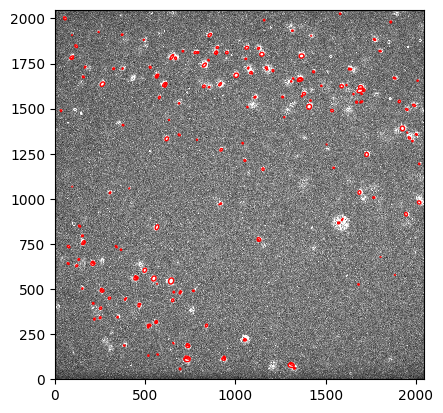

191


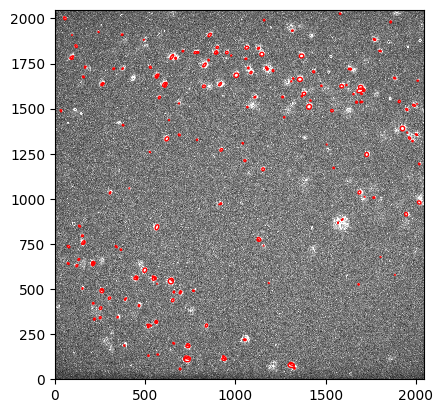

193


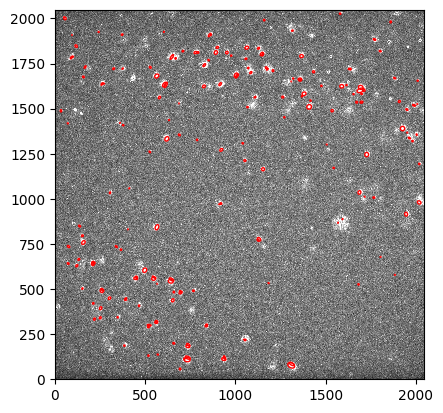

197


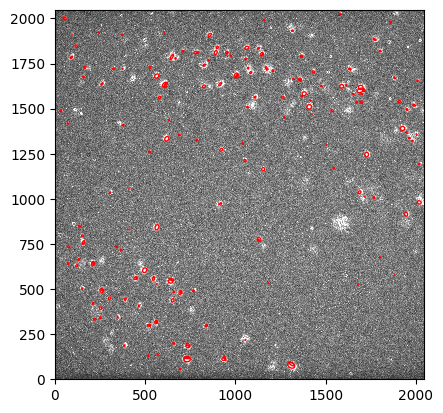

193
channel 0 is below


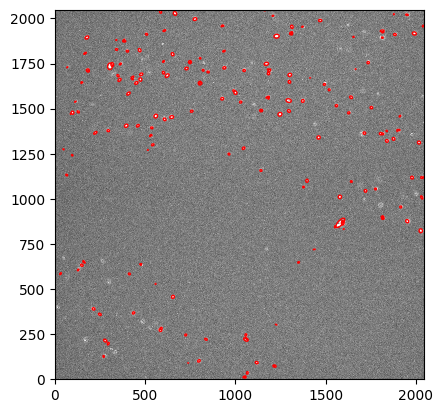

180


In [5]:
#loads in the 3D images

"""
path = "Z:/CCMC_ADMIN/Ben/Dr. Norris' beads"

stack_0 = imread(path+"/main_st-1_bdv.h5 - P_t00000, W_s00_0 - C=0 copy.tif")
#stack_1 = imread(path+"/main_st-1_bdv.h5 - P_t00000, W_s00_0 - C=1 copy.tif")
#stack_2 = imread(path+"/main_st-1_bdv.h5 - P_t00000, W_s00_0 - C=2 copy.tif")

"""
path = "Z:/CCMC_ADMIN/Ben/Dr. Norris' beads/New Bead test"
stack_0 = imread(path+"/main_st-0_bdv.xml - P_t00000, W_s00_0 - C=0.tif")
stack_1 = imread(path+"/main_st-0_bdv.xml - P_t00000, W_s00_0 - C=1.tif")
stack_2 = imread(path+"/main_st-0_bdv.xml - P_t00000, W_s00_0 - C=2.tif")
stack_3 = imread(path+"/main_st-0_bdv.xml - P_t00000, W_s00_0 - C=3.tif")


test_slice = 130
slice_range = 130
test_image = stack_2

#(slice number in channel 0, range of slices to check in the next channel, name of next channel variable
#, detection threshold in other channel, detection threshold in channel 0)
#smaller and negative threshold values will include more beads and vice versa
pos_stack0, slice_num, stack_1beads = bead_detect(test_slice,slice_range,test_image,125,-35) 

In [6]:
#If slices 1 and 2 are appearing as some of the best result, try increasing the test slice in channel 0. 
#This may require a larger shift than it can calculate at the moment.

#(position of beads in channel 0, position of beads in other channel across multipel slices, number of slices to scan in other channel)
difference,rms_0,sorted_dif = offset_function(pos_stack0,stack_1beads,slice_num)

In [7]:
#searches through the best slices and compares the distance between beads to find the slice with the most overlap

#grabs the best slices from the MSD
keys = sorted_dif.keys()
keys = list(keys)

best_slices = keys[:10]

#gets the positions of each bead from the best slices
test_posx = []
test_posy = []
for i in range(len(best_slices)):
    test_posx.append(stack_1beads[best_slices[i]]['x'])
    test_posy.append(stack_1beads[best_slices[i]]['y'])


#converts the positions from the reference channel into a more useable form
posx = []
posy = []
for i in range(len(pos_stack0['x'])):
    posx.append(pos_stack0[i]['x'])
    posy.append(pos_stack0[i]['y'])


#finds all beads within a small distance of the beads in the reference image over only the good slices
pos_dif = {}

#finds the index for both posx[] and test_posx[][] of the smallest distance between each bead
index_min = {}

for i in range(len(best_slices)):
    min_bead = []
    index_temp = {}
    for j in range(len(test_posx[i])):
        placeholder = []
        for k in range(len(posx)):

            distance = np.sqrt((posx[k]-test_posx[i][j])**2+(posy[k]-test_posy[i][j])**2)

            placeholder.append(distance)


        #take the minimum distance value per bead
        min_bead.append(np.min(placeholder))

        #finds the index of the min value
        index_temp.update({j:min(range(len(placeholder)), key=placeholder.__getitem__)})

    index_min.update({best_slices[i]:index_temp})

    #averages all of the smallest distances after using the smallest value
    pos_dif.update({best_slices[i]:np.mean(min_bead)})



#sort by smallest value
pos_sorted = dict(sorted(pos_dif.items(), key=lambda item: item[1]))

#takes the first slice from the list
list_pos = list(pos_sorted)
best_slice = list_pos[0]

In [8]:
#finds the scale factor between each overlapping bead

#posx[] = value
#stack_1beads[best_slice][] = key

#finds the scale factor between each of the two closest beads
scale_xvals = []
scale_yvals = []

#finds a horizontal shift in the image
horiz_shift = []

i = 0
x= []
for key, value in index_min[best_slice].items():
    i+= 1
    x.append(i)

    scale_x = (posx[value]/stack_1beads[best_slice][key]['x'])

    scale_xvals.append(scale_x)

    scale_y = (posy[value]/stack_1beads[best_slice][key]['y'])

    scale_yvals.append(scale_y)
    

    horiz = posx[value] - stack_1beads[best_slice][key]['x']

    horiz_shift.append(horiz)




#Some scale factors values are calcualted between completely different beads
#this loop only allows scale factors within one standard deviation of the average
#the average will be a somewhat decent value since some incorrect scale factors will increase it and others will decrease it
def scale_calc(scale_vals):
    stdev_scale = np.std(scale_vals)
    avg_scale = np.mean(scale_vals)
    
    sum_scale = 0
    counter_scale = 0
    
    for i in range(len(scale_vals)-1):
        if(scale_vals[i] <= avg_scale + stdev_scale and scale_vals[i] >= avg_scale - stdev_scale):
            counter_scale += 1
            sum_scale += scale_vals[i]
    
    scale_factor = sum_scale/counter_scale
    inverse_factor = 1/scale_factor

    return scale_factor,inverse_factor

scale_factorx,inverse_factorx = scale_calc(scale_xvals)
scale_factory,inverse_factory = scale_calc(scale_yvals)


#does the same thing as the scale factor average, but for a horizontal shift
stdev_shift = np.std(horiz_shift)
avg_shift = np.mean(horiz_shift)

sum_shift = 0
counter_shift = 0

for i in range(len(horiz_shift)-1):
    if(horiz_shift[i] <= avg_shift + stdev_shift and horiz_shift[i] >= avg_shift - stdev_shift):
        counter_shift += 1
        sum_shift += horiz_shift[i]


shift_factor = sum_shift/counter_shift


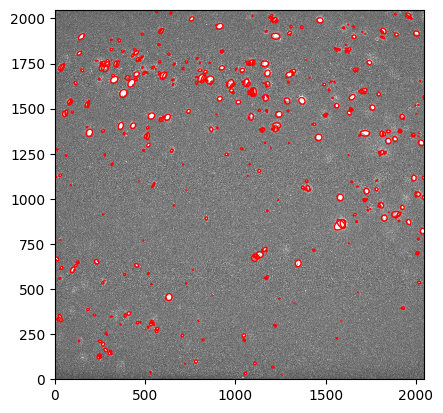

471


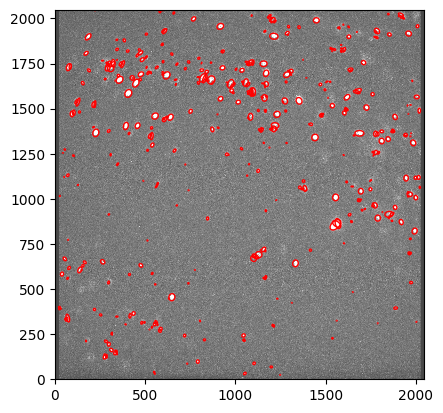

464


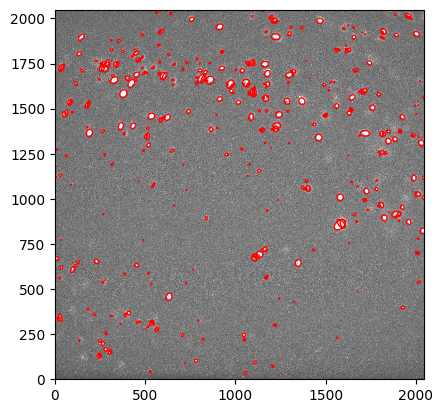

468


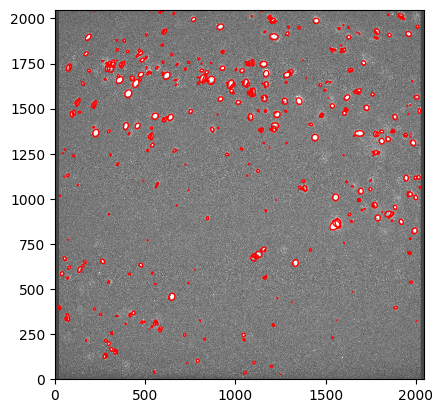

470


In [9]:
#multiplies either image by the scale factor

def scale_factor_func(input_image, scale_factorx, scale_factory, threshold):
    img = input_image
    h, w = img.shape[:2]

    # Scale the image (only x in this case)
    scaled_img = cv2.resize(img, None, fx=scale_factorx, fy=scale_factory)

    sh, sw = scaled_img.shape[:2]

    # Create an output canvas the same size as the original image
    padded_scaled = np.zeros_like(img)

    # Compute start/end indices for placing the scaled image centered
    # in the original image
    y_start = max(0, int((h - sh) / 2))
    y_end = y_start + min(sh, h)
    x_start = max(0, int((w - sw) / 2))
    x_end = x_start + min(sw, w)

    # Compute crop window in the scaled image
    crop_y_start = max(0, -int((h - sh) / 2))
    crop_y_end = crop_y_start + (y_end - y_start)
    crop_x_start = max(0, -int((w - sw) / 2))
    crop_x_end = crop_x_start + (x_end - x_start)

    # Copy the valid region from the scaled image to the padded canvas
    padded_scaled[y_start:y_end, x_start:x_end] = scaled_img[crop_y_start:crop_y_end, crop_x_start:crop_x_end]

    rescaled_pos = star_counter_position(padded_scaled, threshold)
    return rescaled_pos

#tries all four possible scale factors and eventually wil choose the best combination
rescaled_pos_xy = scale_factor_func(test_image[best_slice],scale_factorx, scale_factory,np.mean(test_image[best_slice])*2)
rescaled_pos_xiy = scale_factor_func(test_image[best_slice],inverse_factorx, scale_factory,np.mean(test_image[best_slice])*2)
rescaled_pos_xyi = scale_factor_func(test_image[best_slice],scale_factorx, inverse_factory,np.mean(test_image[best_slice])*2)
rescaled_pos_xiyi = scale_factor_func(test_image[best_slice],inverse_factorx, inverse_factory,np.mean(test_image[best_slice])*2)

all_scaled = [[rescaled_pos_xy,scale_factorx, scale_factory],[rescaled_pos_xiy,inverse_factorx, scale_factory] \
              ,[rescaled_pos_xyi,scale_factorx, inverse_factory],[rescaled_pos_xiyi,inverse_factorx, inverse_factory]]

In [10]:
#shifts an image horizontally
def shift(arr, num, fill_value=np.nan):
    result = np.empty_like(arr)
    if num > 0:
        result[:num] = fill_value
        result[num:] = arr[:-num]
    elif num < 0:
        result[num:] = fill_value
        result[:num] = arr[-num:]
    else:
        result[:] = arr
    return result

#the input image must be rotated 90 degress since the funciton only shifts vertically
#shift factor must be multiplied by -1 to move it in the proper direction
stack_1shift = shift(np.rot90(test_image[best_slice]),int(-shift_factor), fill_value=0)

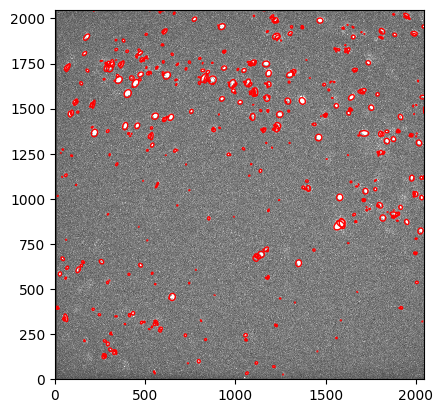

535


In [11]:
#shift the output back into place with 1 -90 degree shift
stack_1shifted = np.rot90(stack_1shift,-1)

reshifted_pos = star_counter_position(stack_1shifted,np.mean(stack_1shifted)*2)

In [12]:
#checks if a shift in x values or a scale factor is a better fit for the image

#runs through all 4 scale factor combinations and uses the best one
def scale_check(rescaled_pos):
    pos_scale = []
    min_scale = []
    
    
    for j in range(len(rescaled_pos['x'])):
        placeholder_scale = []
        for k in range(len(posx)):
    
            dist_scale = np.sqrt((posx[k]-rescaled_pos[j]['x'])**2+(posy[k]-rescaled_pos[j]['y'])**2)
    
            placeholder_scale.append(dist_scale)
    
        #take the minimum distance value per bead
        min_scale.append(np.min(placeholder_scale))
    
    pos_scale.append(np.mean(min_scale))

    return pos_scale

#uses the best of the four combinations
all_scale_pos = []
for i in range(len(all_scaled)):
    all_scale_pos.append(scale_check(all_scaled[i][0]))

#finds the list that contains the best x and y factors
best_scale = min(range(len(all_scale_pos)), key=all_scale_pos.__getitem__)

#the best fit x and y scale factors
x_scale = all_scaled[best_scale][1]
y_scale = all_scaled[best_scale][2]


pos_shift = []
min_shift = []

for j in range(len(reshifted_pos['x'])):
    placeholder_shift = []
    for k in range(len(posx)):

        dist_shift = np.sqrt((posx[k]-reshifted_pos[j]['x'])**2+(posy[k]-reshifted_pos[j]['y'])**2)

        placeholder_shift.append(dist_shift)

    #take the minimum distance value per bead
    min_shift.append(np.min(placeholder_shift))

           
pos_shift.append(np.mean(min_shift))

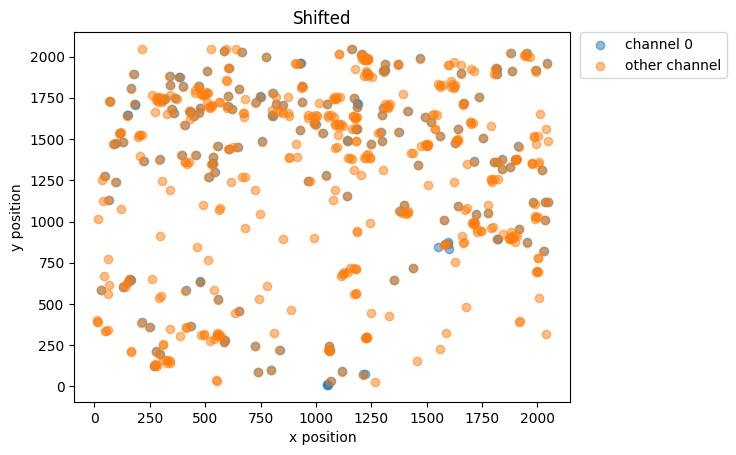

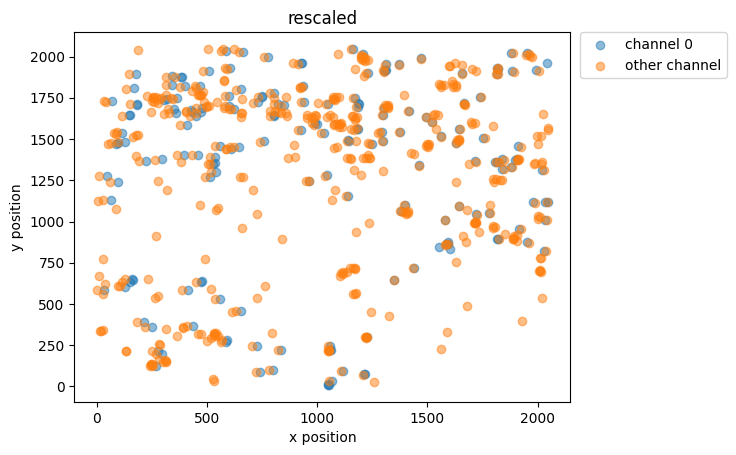

In [13]:
plt.scatter(pos_stack0['x'],pos_stack0['y'], alpha = 0.5, label = "channel 0")
plt.scatter(reshifted_pos['x'],reshifted_pos['y'], alpha = 0.5, label = "other channel")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("Shifted")
plt.xlabel("x position")
plt.ylabel("y position")
plt.show()

plt.scatter(pos_stack0['x'],pos_stack0['y'], alpha = 0.5, label = "channel 0")
plt.scatter(all_scaled[best_scale][0]['x'],all_scaled[best_scale][0]['y'], alpha = 0.5, label = "other channel")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.title("rescaled")
plt.xlabel("x position")
plt.ylabel("y position")
plt.show()

In [14]:
print("best slice in the test channel =",best_slice+1)
print("Z difference between slices =",test_slice-(best_slice+1))
print("positive means the test channel needs to move down and vice versa")

print()
print("horizontal shift =",shift_factor)
print("positive means the test channel needs to be moved to the right and vice versa")


x_half = len(stack_3[0])/2
y_half = len(stack_3[0][0])/2
print()
print("x scale factor =",x_scale)
print("y scale factor =",y_scale,"\n")
print("multiply the test channel by the matrix below for a scale factor")
print()
print(f" [{x_scale}, 0 , {(-x_scale*x_half)+x_half}]\n \
[0, {y_scale} , {(-y_scale*y_half)+y_half}]\n \
[0, 0 , 1] \
")
print()

print()
print("Lower values mean that method overlaps better with the test channel and should be used")
print("rescale value =",all_scale_pos[best_scale])
print("shift factor value=",pos_shift)

best slice in the test channel = 22
Z difference between slices = 108
positive means the test channel needs to move down and vice versa

horizontal shift = 10.532615368813735
positive means the test channel needs to be moved to the right and vice versa

x scale factor = 1.022606862488312
y scale factor = 0.998225780225744 

multiply the test channel by the matrix below for a scale factor

 [1.022606862488312, 0 , -23.160730619275682]
 [0, 0.998225780225744 , 1.8176881587252183]
 [0, 0 , 1] 


Lower values mean that method overlaps better with the test channel and should be used
rescale value = [58.46354981523225]
shift factor value= [57.14350716168752]
